In [16]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
from tqdm import tqdm
import torchvision.datasets as datasets
from torchvision.datasets import ImageFolder
from torchvision.utils import make_grid
import torchvision.utils as vutils
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
from torch.utils.data import Subset
import numpy as np

In [17]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
LEARNING_RATE = 2e-4  # could also use two lrs, one for gen and one for disc
BATCH_SIZE = 128
IMAGE_SIZE = 64
CHANNELS_IMG = 3
Z_DIM = 100
NUM_EPOCHS = 50
FEATURES_DISC = 64
FEATURES_GEN = 64

In [18]:
transform = transforms.Compose([
    transforms.Resize((IMAGE_SIZE, IMAGE_SIZE)),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

dataset = datasets.ImageFolder('images', transform=transform)
dataloader = DataLoader(dataset=dataset, batch_size=BATCH_SIZE, shuffle=True)

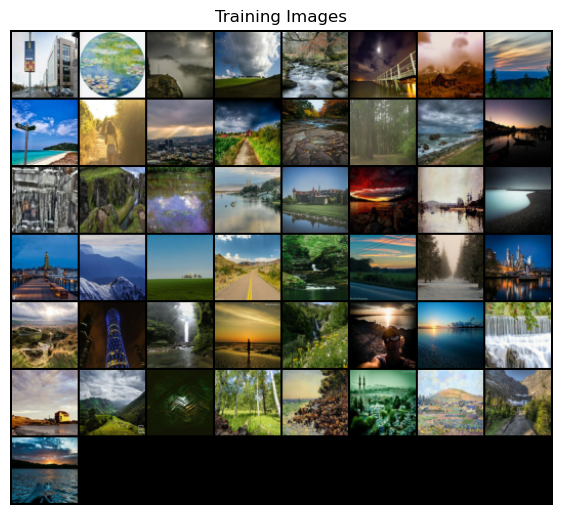

In [19]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(7,7))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:49], padding=2, normalize=True).cpu(),(1,2,0)))

In [20]:
class Generator(nn.Module):
    def __init__(self, z_dim, channels_img, features_g):
        super(Generator, self).__init__()
        self.net = nn.Sequential(
            self._block(z_dim, features_g * 16, 4, 1, 0),
            self._block(features_g * 16, features_g * 8, 4, 2, 1),
            self._block(features_g * 8, features_g * 4, 4, 2, 1),
            self._block(features_g * 4, features_g * 2, 4, 2, 1),
            nn.ConvTranspose2d(
                features_g * 2, channels_img, kernel_size=4, stride=2, padding=1
            ),
            nn.Tanh()
        )

    def _block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(
            nn.ConvTranspose2d(
                in_channels,
                out_channels,
                kernel_size,
                stride,
                padding,
                bias=False
            ),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )

    def forward(self, x):
        return self.net(x)

In [21]:
class Discriminator(nn.Module):
    def __init__(self, channels_img, features_d):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            nn.Conv2d(channels_img, features_d, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2),
            self._block(features_d, features_d * 2, 4, 2, 1),
            self._block(features_d * 2, features_d * 4, 4, 2, 1),
            self._block(features_d * 4, features_d * 8, 4, 2, 1),
            nn.Conv2d(features_d * 8, 1, kernel_size=4, stride=2, padding=0),
            nn.Sigmoid()
        )

    def _block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(
            nn.Conv2d(
                in_channels,
                out_channels,
                kernel_size,
                stride,
                padding,
                bias=False
            ),
            nn.BatchNorm2d(out_channels),
            nn.LeakyReLU(0.2)
        )

    def forward(self, x):
        return self.disc(x)

In [22]:
def initialize_weights(model):
    classname = model.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(model.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(model.weight.data, 1.0, 0.02)
        nn.init.constant_(model.bias.data, 0)

In [23]:
gen = Generator(Z_DIM, CHANNELS_IMG, FEATURES_GEN).to(device)
disc = Discriminator(CHANNELS_IMG, FEATURES_DISC).to(device)

initialize_weights(gen)
initialize_weights(disc)

In [24]:
opt_gen = optim.Adam(gen.parameters(), lr=LEARNING_RATE, betas=(0.5, 0.999))
opt_disc = optim.Adam(disc.parameters(), lr=LEARNING_RATE, betas=(0.5, 0.999))
criterion = nn.BCELoss()

fixed_noise = torch.randn(32, Z_DIM, 1, 1).to(device)

In [25]:
def show_tensor_images(image_tensor, num_images=32, size=(1, 64, 64)):
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=4)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

Epoch [0/50] Batch 0/58                   Loss D: 0.7675, loss G: 1.8122


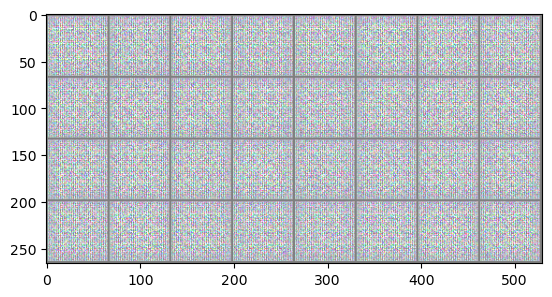

Epoch [0/50] Batch 50/58                   Loss D: 0.0286, loss G: 4.5747


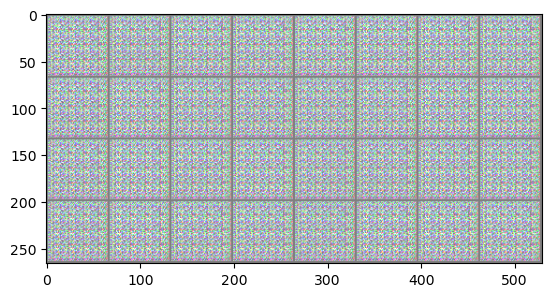

Epoch [1/50] Batch 0/58                   Loss D: 1.0726, loss G: 13.5775


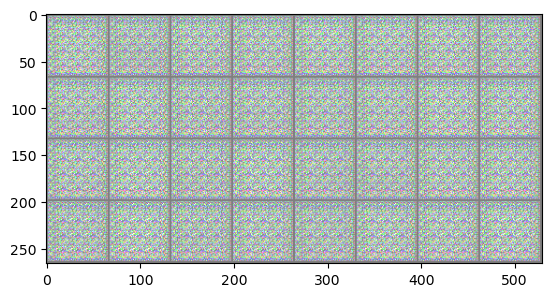

Epoch [1/50] Batch 50/58                   Loss D: 0.3495, loss G: 2.7177


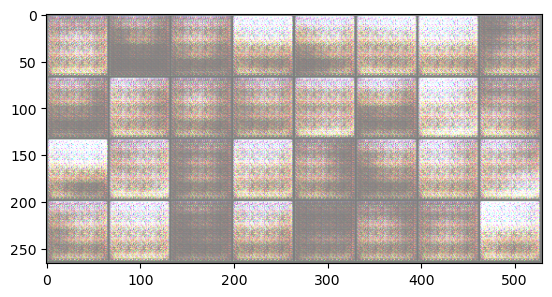

Epoch [2/50] Batch 0/58                   Loss D: 0.2785, loss G: 3.1155


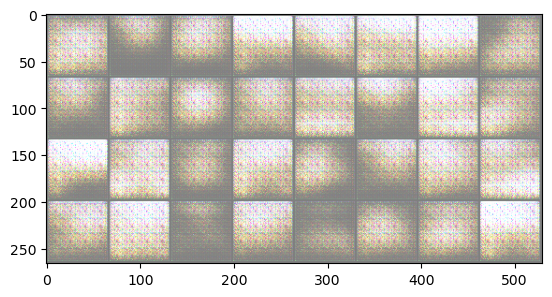

Epoch [2/50] Batch 50/58                   Loss D: 0.3063, loss G: 3.1732


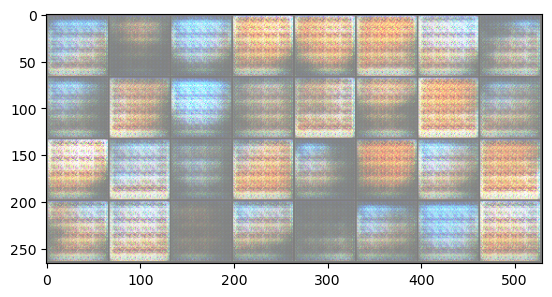

Epoch [3/50] Batch 0/58                   Loss D: 0.5599, loss G: 0.5826


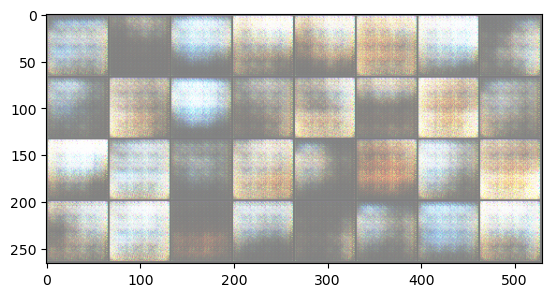

Epoch [3/50] Batch 50/58                   Loss D: 0.6156, loss G: 2.0860


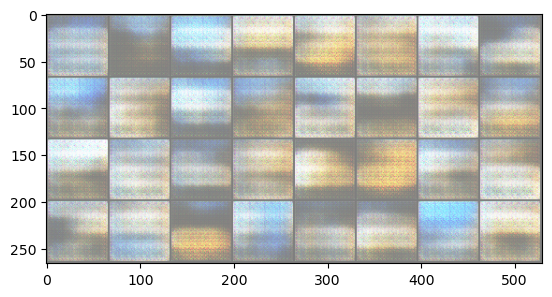

Epoch [4/50] Batch 0/58                   Loss D: 0.3261, loss G: 1.9090


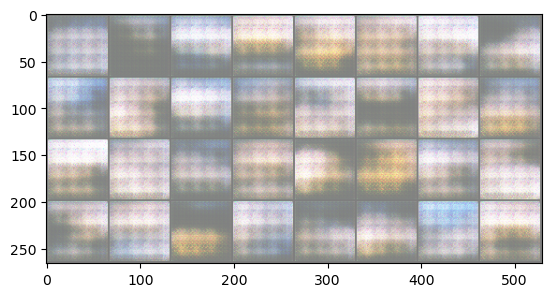

Epoch [4/50] Batch 50/58                   Loss D: 0.6290, loss G: 1.9810


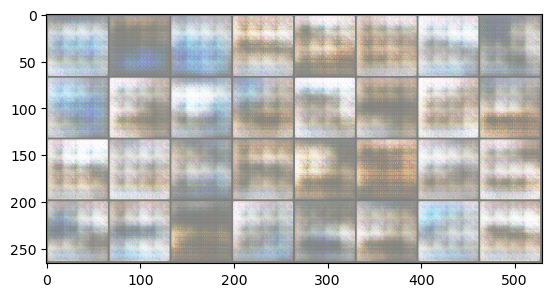

Epoch [5/50] Batch 0/58                   Loss D: 0.5187, loss G: 0.8308


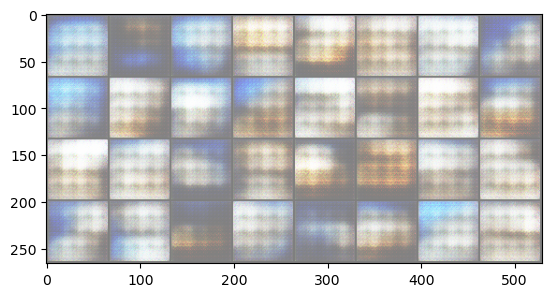

Epoch [5/50] Batch 50/58                   Loss D: 0.5597, loss G: 1.6486


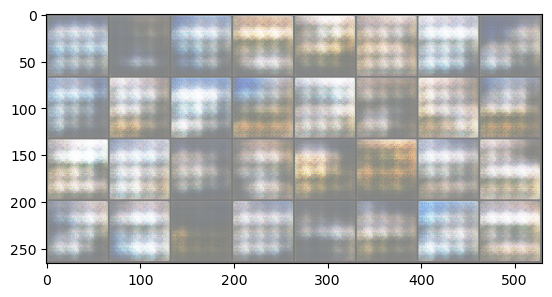

Epoch [6/50] Batch 0/58                   Loss D: 0.5148, loss G: 1.1842


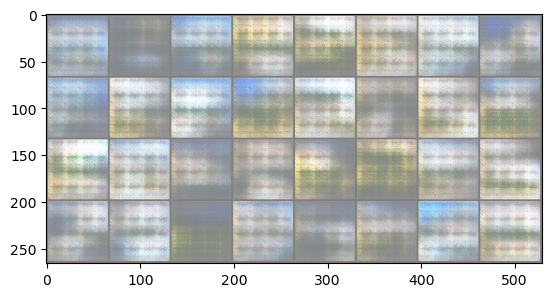

Epoch [6/50] Batch 50/58                   Loss D: 0.4767, loss G: 1.7531


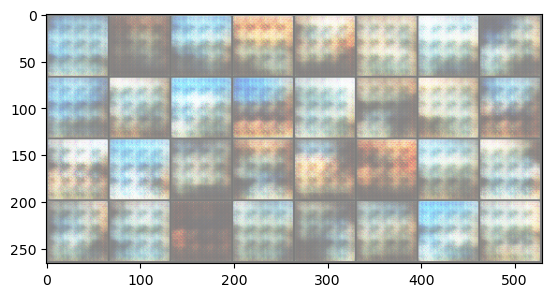

Epoch [7/50] Batch 0/58                   Loss D: 0.3213, loss G: 2.7709


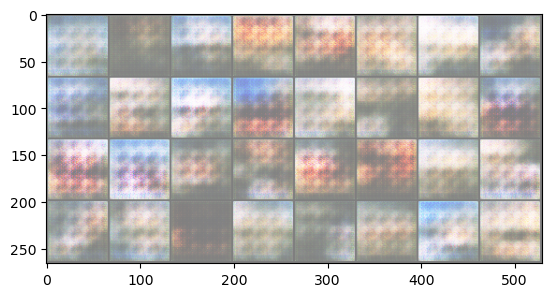

Epoch [7/50] Batch 50/58                   Loss D: 0.3586, loss G: 2.5706


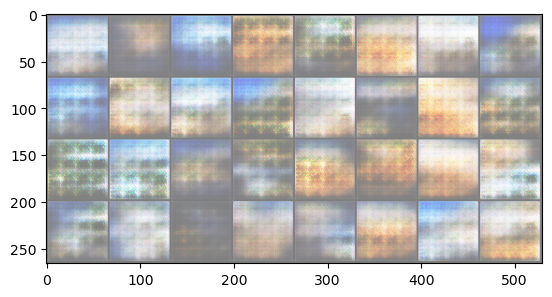

Epoch [8/50] Batch 0/58                   Loss D: 0.5021, loss G: 1.7683


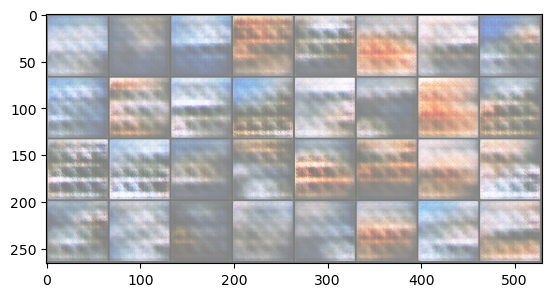

Epoch [8/50] Batch 50/58                   Loss D: 0.4862, loss G: 2.4800


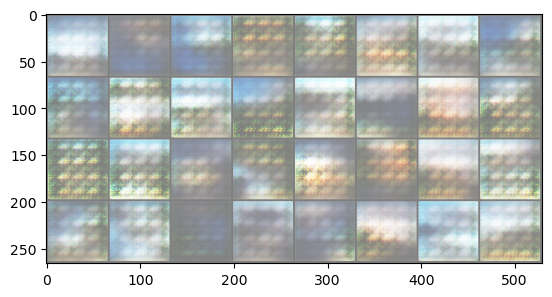

Epoch [9/50] Batch 0/58                   Loss D: 0.3253, loss G: 2.3750


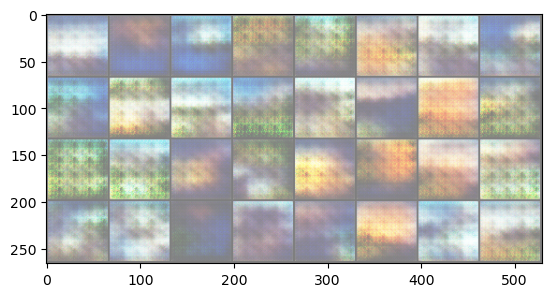

Epoch [9/50] Batch 50/58                   Loss D: 0.4308, loss G: 2.1440


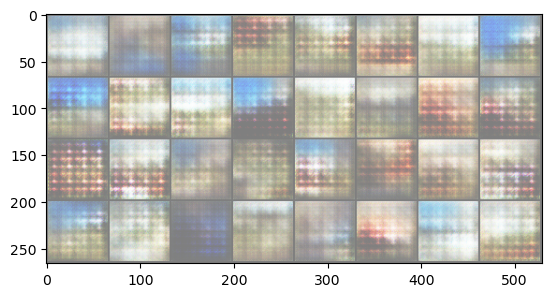

Epoch [10/50] Batch 0/58                   Loss D: 0.6912, loss G: 2.7528


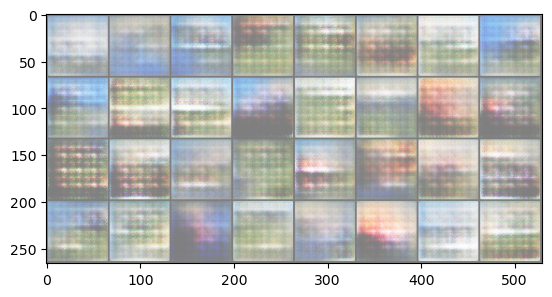

Epoch [10/50] Batch 50/58                   Loss D: 0.4489, loss G: 1.6567


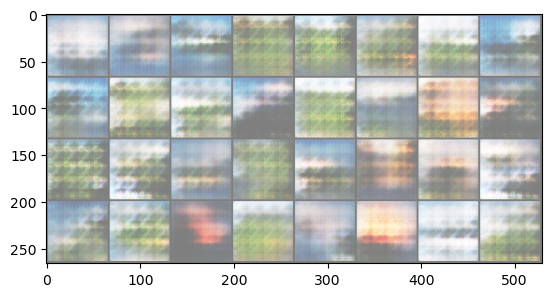

Epoch [11/50] Batch 0/58                   Loss D: 0.4762, loss G: 2.1275


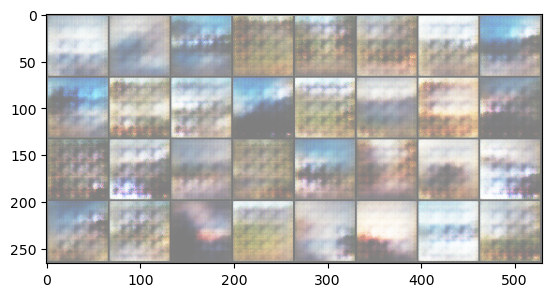

Epoch [11/50] Batch 50/58                   Loss D: 0.3670, loss G: 2.0429


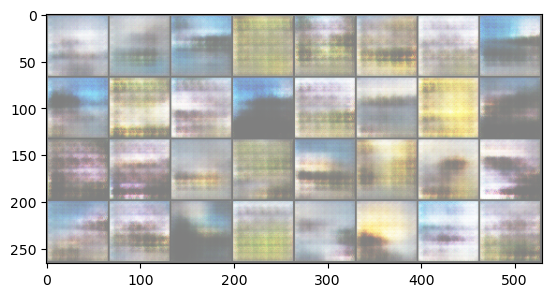

Epoch [12/50] Batch 0/58                   Loss D: 0.2230, loss G: 2.5359


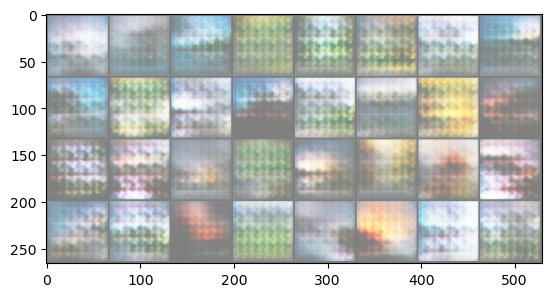

Epoch [12/50] Batch 50/58                   Loss D: 0.6645, loss G: 2.9817


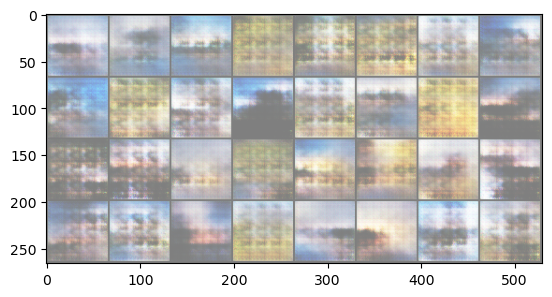

Epoch [13/50] Batch 0/58                   Loss D: 0.3293, loss G: 3.4243


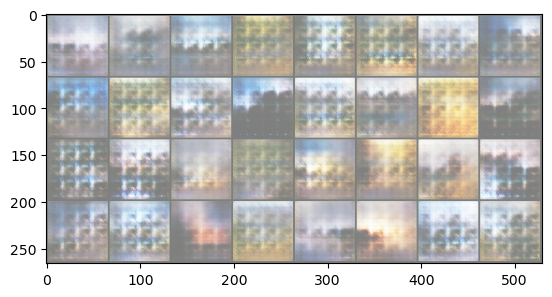

Epoch [13/50] Batch 50/58                   Loss D: 0.3320, loss G: 3.7500


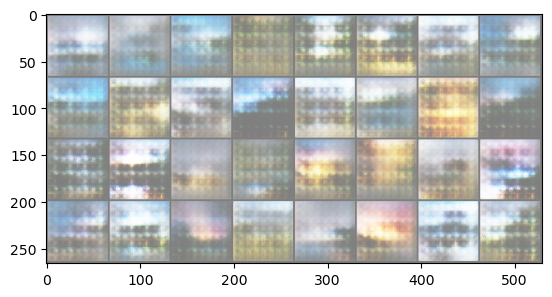

Epoch [14/50] Batch 0/58                   Loss D: 0.3322, loss G: 3.0886


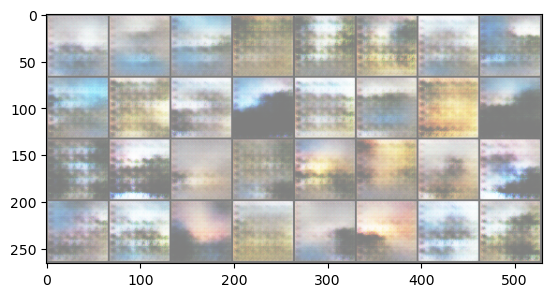

Epoch [14/50] Batch 50/58                   Loss D: 0.2930, loss G: 3.0495


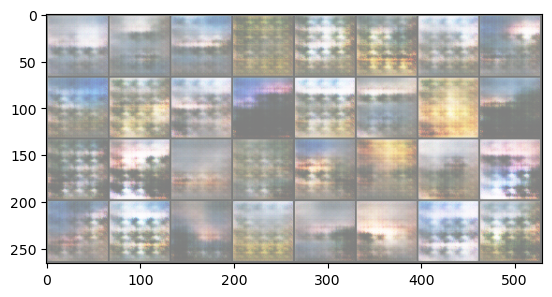

Epoch [15/50] Batch 0/58                   Loss D: 0.4368, loss G: 2.6390


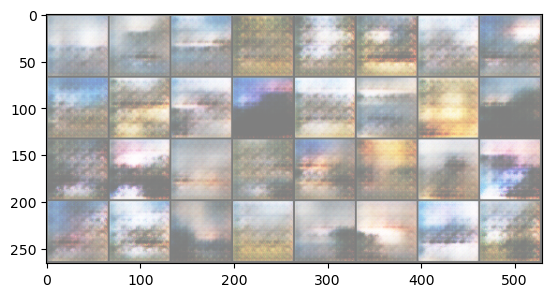

Epoch [15/50] Batch 50/58                   Loss D: 0.5077, loss G: 2.3735


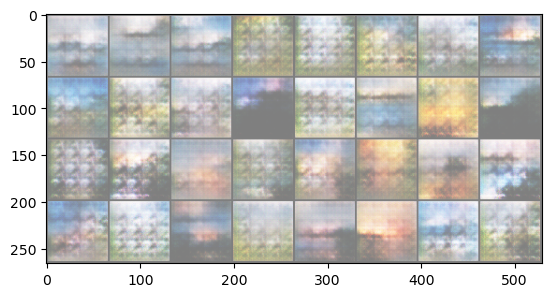

Epoch [16/50] Batch 0/58                   Loss D: 0.2406, loss G: 3.0060


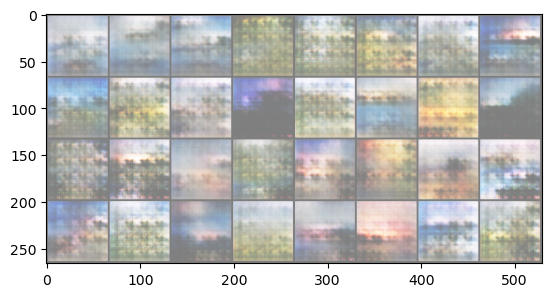

Epoch [16/50] Batch 50/58                   Loss D: 0.5813, loss G: 4.4062


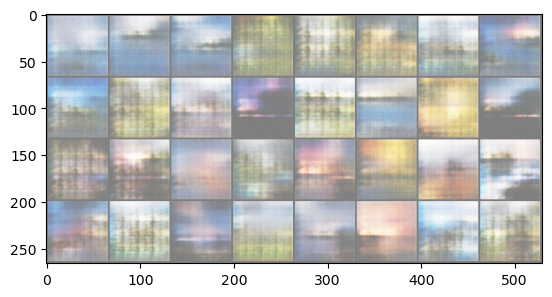

Epoch [17/50] Batch 0/58                   Loss D: 0.0908, loss G: 3.2492


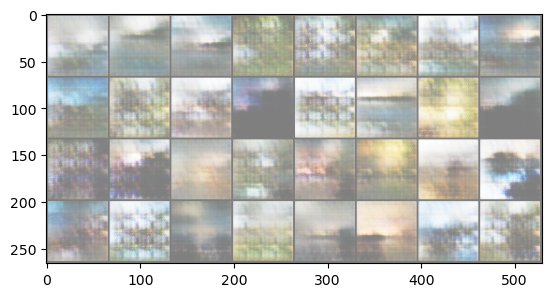

Epoch [17/50] Batch 50/58                   Loss D: 0.6976, loss G: 4.9859


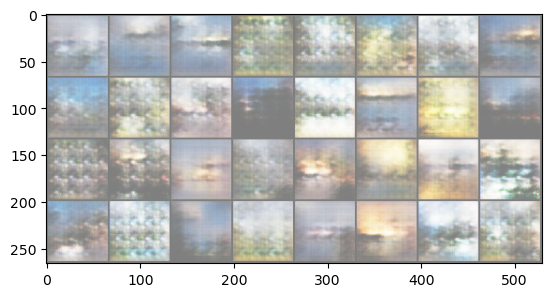

Epoch [18/50] Batch 0/58                   Loss D: 0.1369, loss G: 2.5132


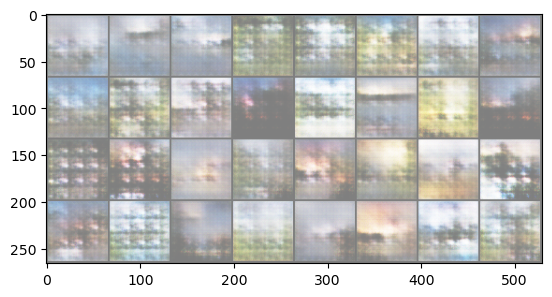

Epoch [18/50] Batch 50/58                   Loss D: 0.3860, loss G: 3.9982


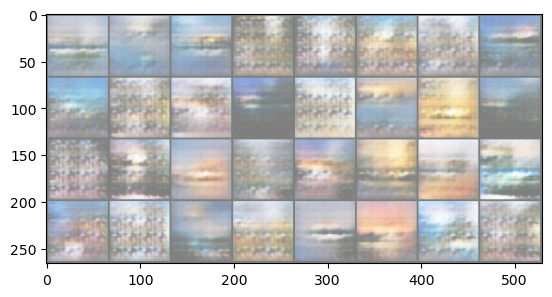

Epoch [19/50] Batch 0/58                   Loss D: 0.0930, loss G: 3.9602


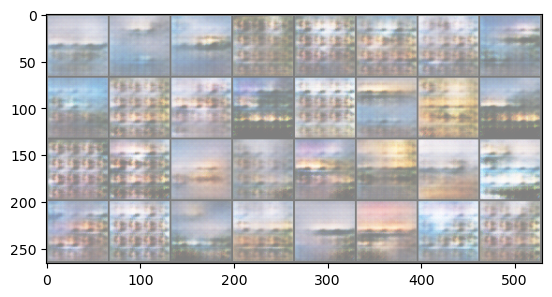

Epoch [19/50] Batch 50/58                   Loss D: 0.1651, loss G: 2.5771


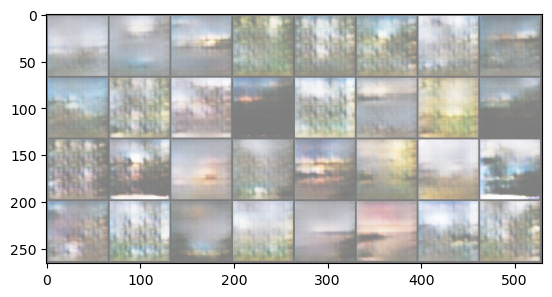

Epoch [20/50] Batch 0/58                   Loss D: 0.6221, loss G: 3.8831


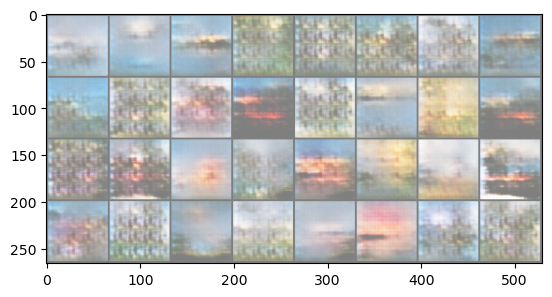

Epoch [20/50] Batch 50/58                   Loss D: 0.6327, loss G: 5.3388


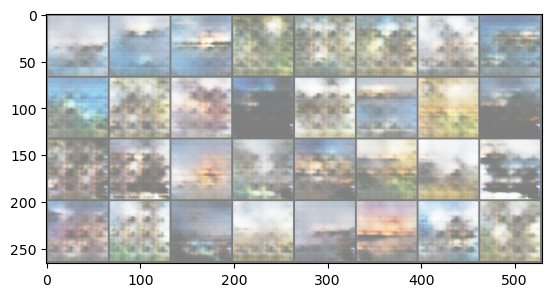

Epoch [21/50] Batch 0/58                   Loss D: 0.1114, loss G: 2.1358


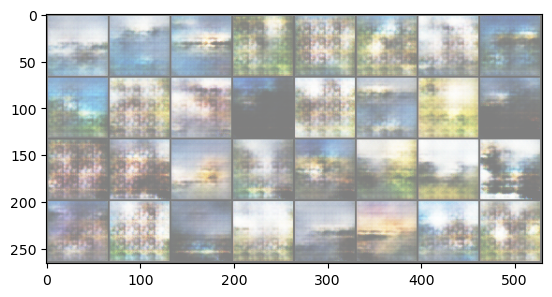

Epoch [21/50] Batch 50/58                   Loss D: 0.1778, loss G: 4.8089


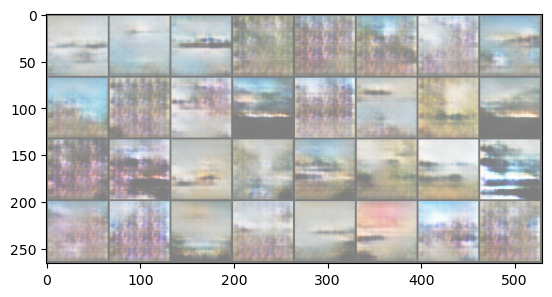

Epoch [22/50] Batch 0/58                   Loss D: 0.1916, loss G: 3.2148


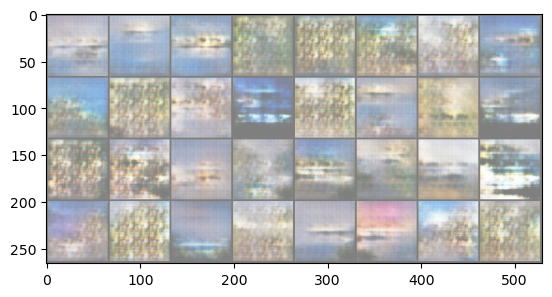

Epoch [22/50] Batch 50/58                   Loss D: 0.1023, loss G: 4.8935


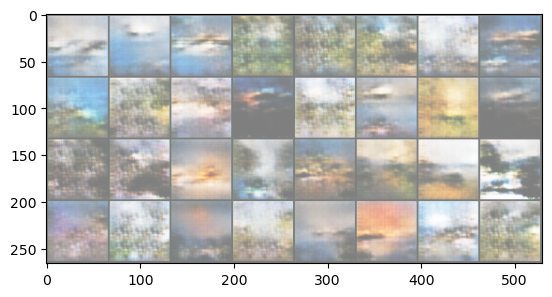

Epoch [23/50] Batch 0/58                   Loss D: 0.6720, loss G: 4.8642


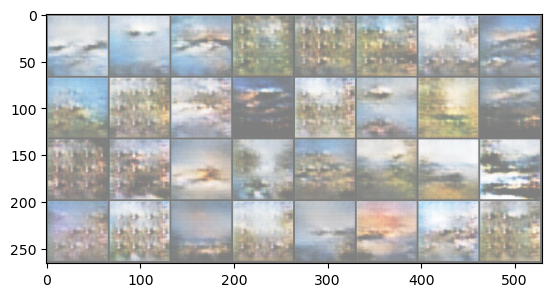

Epoch [23/50] Batch 50/58                   Loss D: 0.2915, loss G: 4.5111


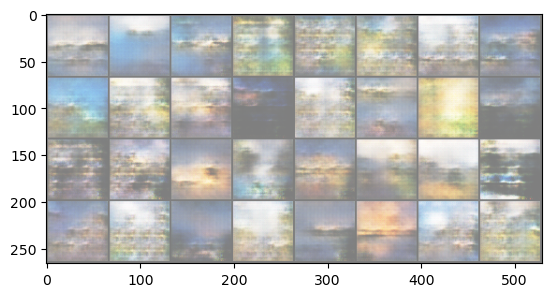

Epoch [24/50] Batch 0/58                   Loss D: 0.2646, loss G: 2.8516


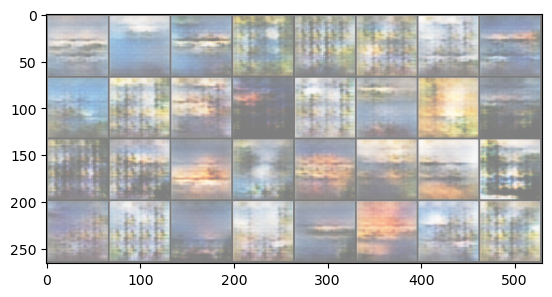

Epoch [24/50] Batch 50/58                   Loss D: 0.0720, loss G: 3.1780


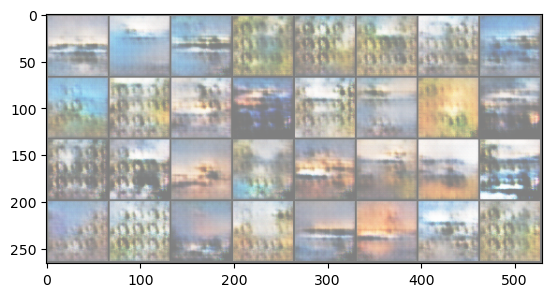

Epoch [25/50] Batch 0/58                   Loss D: 0.0405, loss G: 4.0387


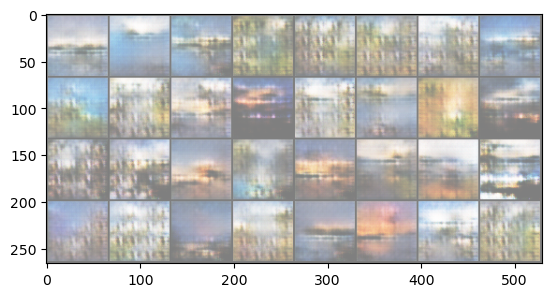

Epoch [25/50] Batch 50/58                   Loss D: 0.1280, loss G: 3.1171


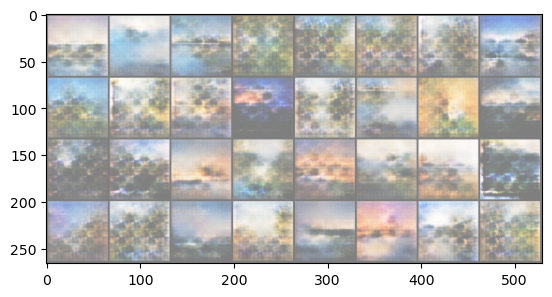

Epoch [26/50] Batch 0/58                   Loss D: 0.2036, loss G: 5.4898


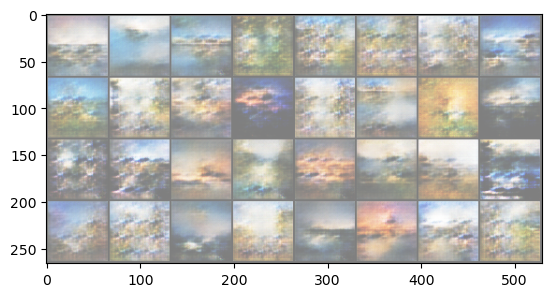

Epoch [26/50] Batch 50/58                   Loss D: 0.1442, loss G: 3.7458


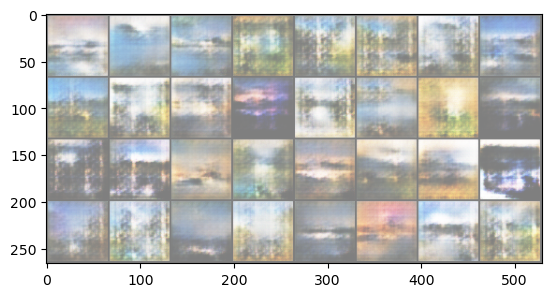

Epoch [27/50] Batch 0/58                   Loss D: 0.4882, loss G: 5.1250


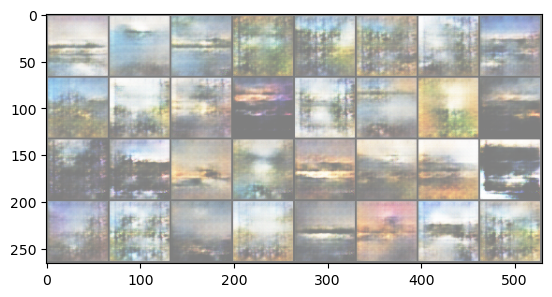

Epoch [27/50] Batch 50/58                   Loss D: 0.0386, loss G: 5.4850


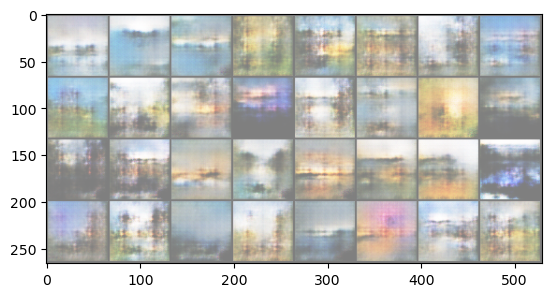

Epoch [28/50] Batch 0/58                   Loss D: 0.2198, loss G: 3.4159


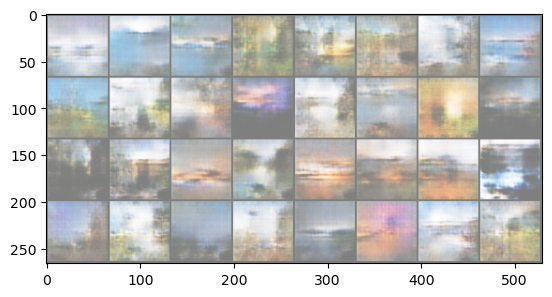

Epoch [28/50] Batch 50/58                   Loss D: 0.1109, loss G: 3.2764


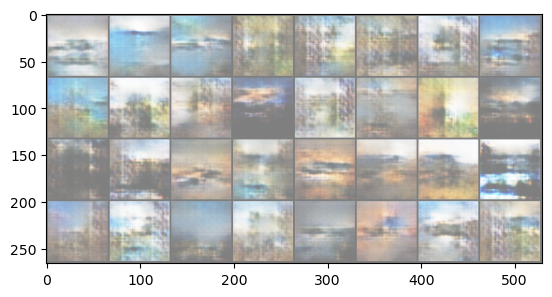

Epoch [29/50] Batch 0/58                   Loss D: 0.0257, loss G: 4.5992


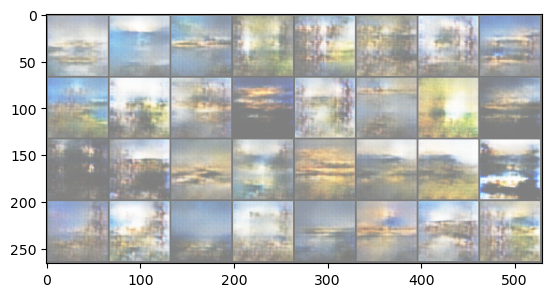

Epoch [29/50] Batch 50/58                   Loss D: 0.7671, loss G: 3.4532


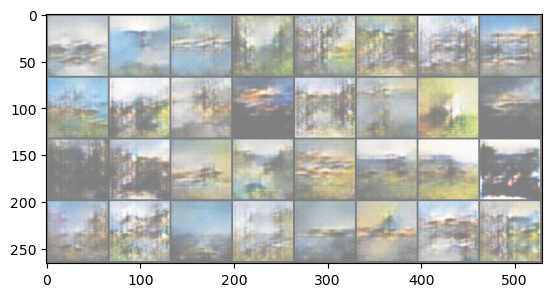

Epoch [30/50] Batch 0/58                   Loss D: 0.1339, loss G: 3.3052


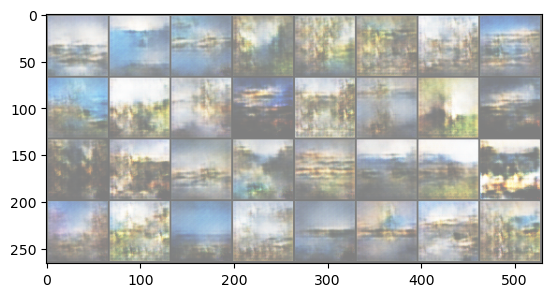

Epoch [30/50] Batch 50/58                   Loss D: 0.0468, loss G: 5.3594


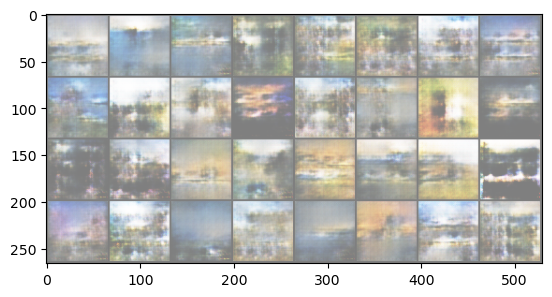

Epoch [31/50] Batch 0/58                   Loss D: 0.0771, loss G: 4.0025


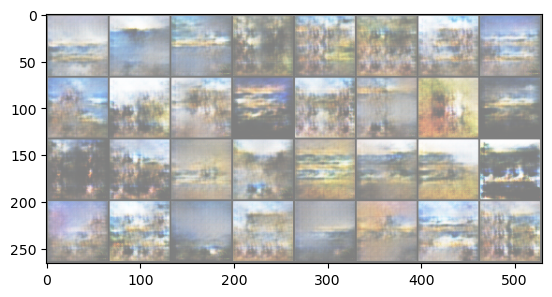

Epoch [31/50] Batch 50/58                   Loss D: 0.6717, loss G: 2.1103


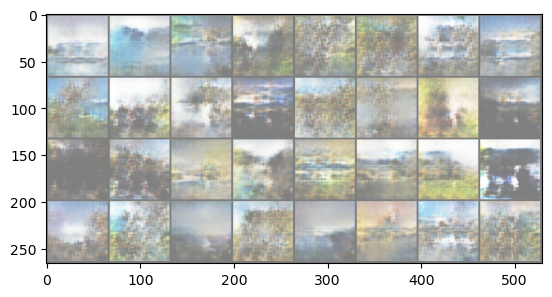

Epoch [32/50] Batch 0/58                   Loss D: 0.3815, loss G: 6.2854


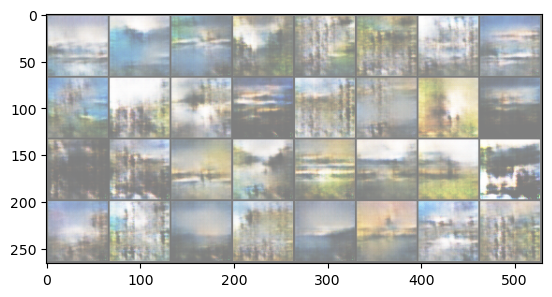

Epoch [32/50] Batch 50/58                   Loss D: 0.5987, loss G: 5.8057


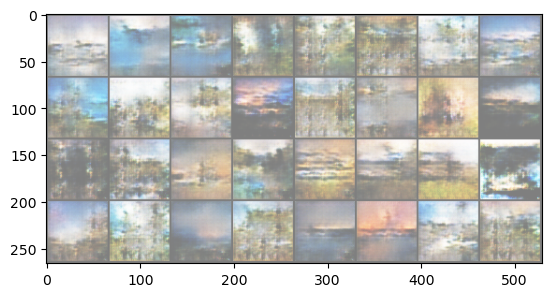

Epoch [33/50] Batch 0/58                   Loss D: 0.3192, loss G: 5.1394


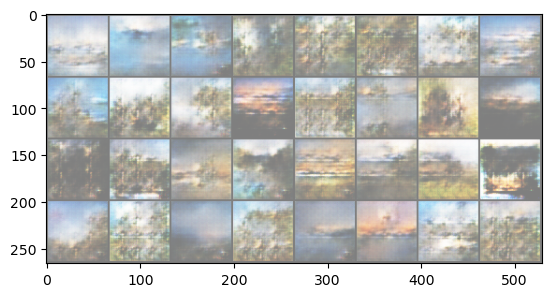

Epoch [33/50] Batch 50/58                   Loss D: 0.1743, loss G: 3.2552


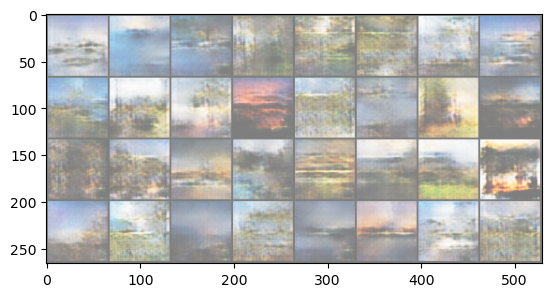

Epoch [34/50] Batch 0/58                   Loss D: 0.0190, loss G: 6.9984


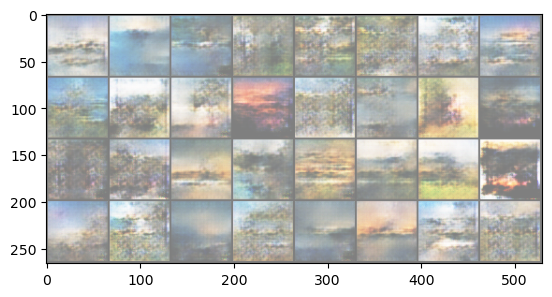

Epoch [34/50] Batch 50/58                   Loss D: 0.1786, loss G: 4.3896


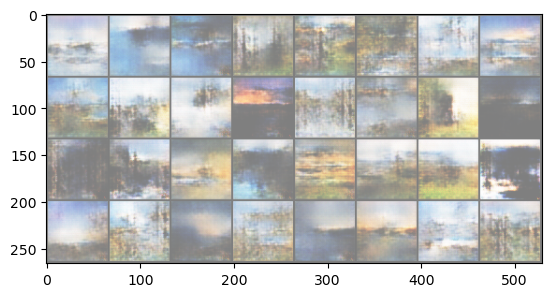

Epoch [35/50] Batch 0/58                   Loss D: 0.2562, loss G: 4.1431


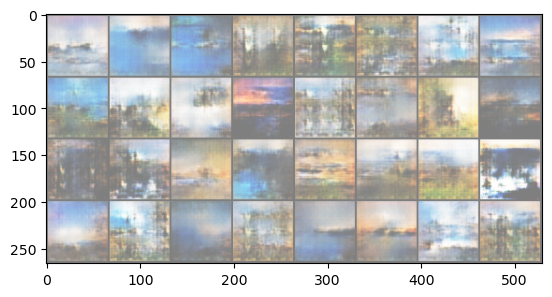

Epoch [35/50] Batch 50/58                   Loss D: 0.0584, loss G: 9.2014


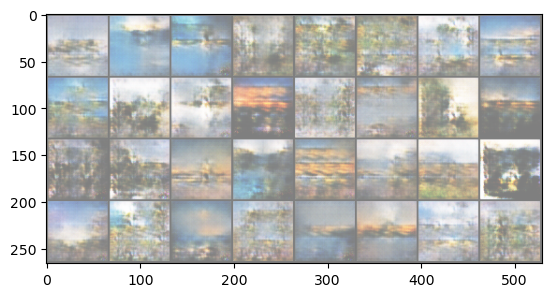

Epoch [36/50] Batch 0/58                   Loss D: 0.0783, loss G: 8.0119


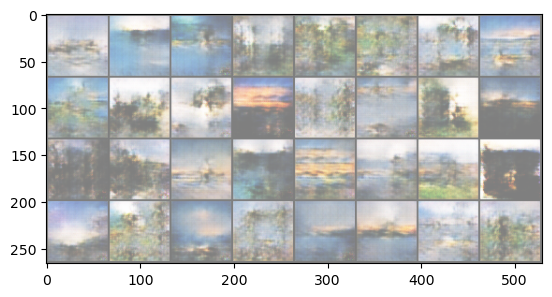

Epoch [36/50] Batch 50/58                   Loss D: 0.4149, loss G: 6.5903


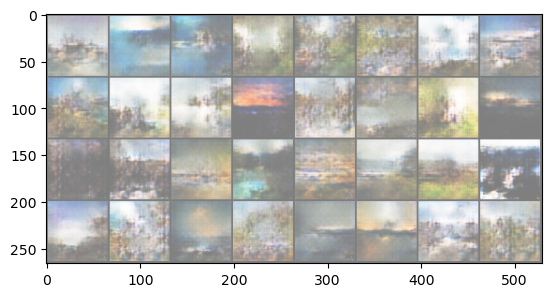

Epoch [37/50] Batch 0/58                   Loss D: 0.0397, loss G: 3.3038


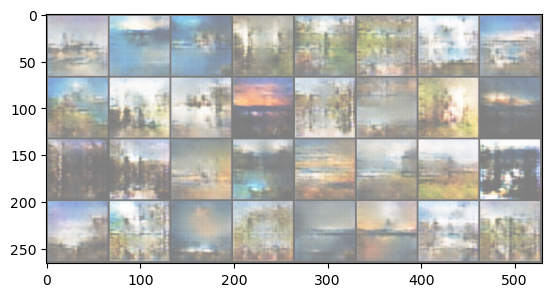

Epoch [37/50] Batch 50/58                   Loss D: 0.1731, loss G: 7.0997


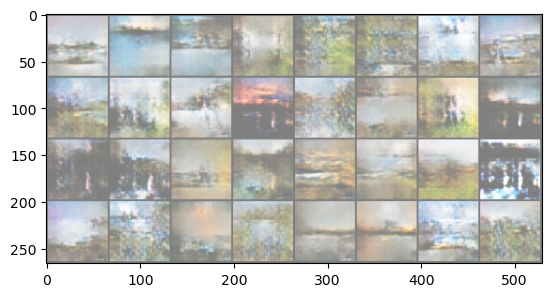

Epoch [38/50] Batch 0/58                   Loss D: 0.2255, loss G: 7.4676


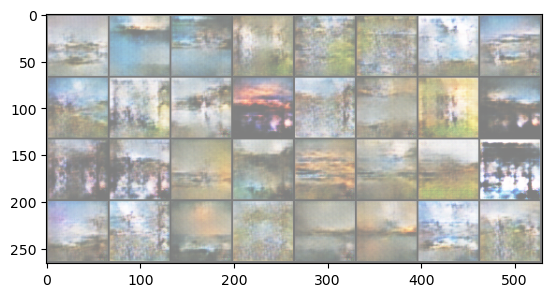

Epoch [38/50] Batch 50/58                   Loss D: 0.2734, loss G: 4.5868


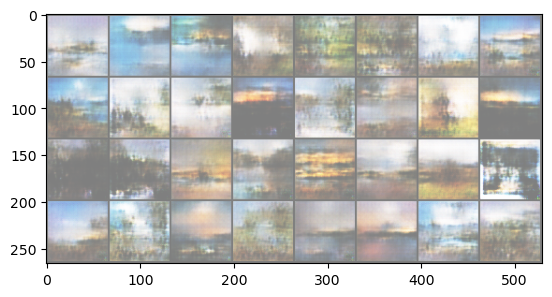

Epoch [39/50] Batch 0/58                   Loss D: 0.2367, loss G: 8.6715


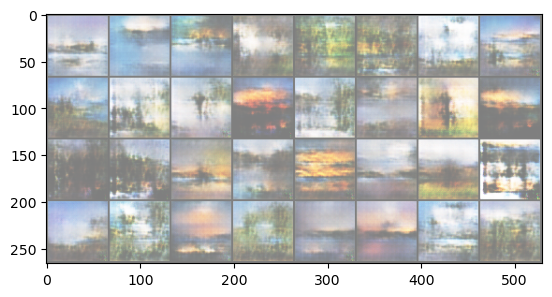

Epoch [39/50] Batch 50/58                   Loss D: 0.4838, loss G: 4.9012


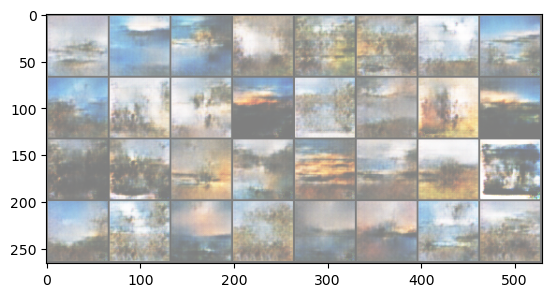

Epoch [40/50] Batch 0/58                   Loss D: 0.0387, loss G: 3.6358


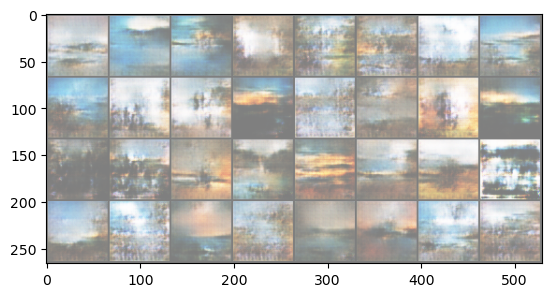

Epoch [40/50] Batch 50/58                   Loss D: 0.0437, loss G: 5.2368


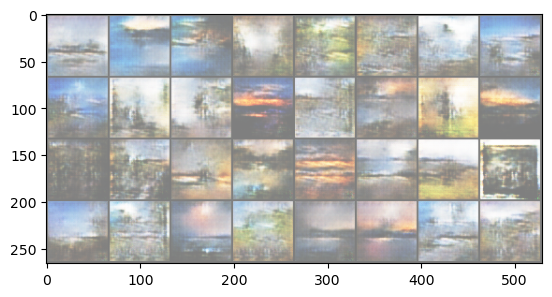

Epoch [41/50] Batch 0/58                   Loss D: 0.0394, loss G: 3.7429


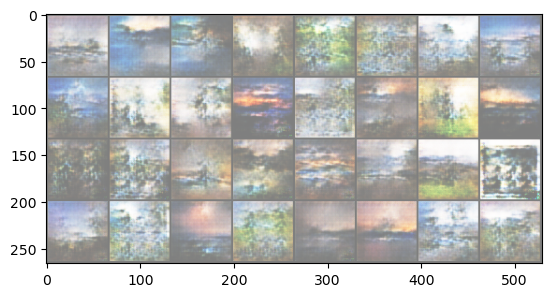

Epoch [41/50] Batch 50/58                   Loss D: 0.0781, loss G: 4.6985


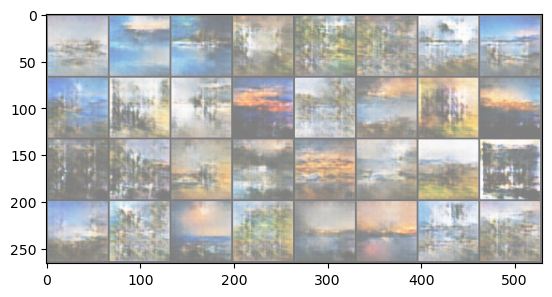

Epoch [42/50] Batch 0/58                   Loss D: 0.0816, loss G: 4.2618


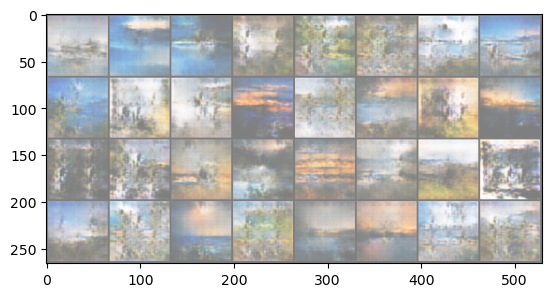

Epoch [42/50] Batch 50/58                   Loss D: 0.0697, loss G: 4.0878


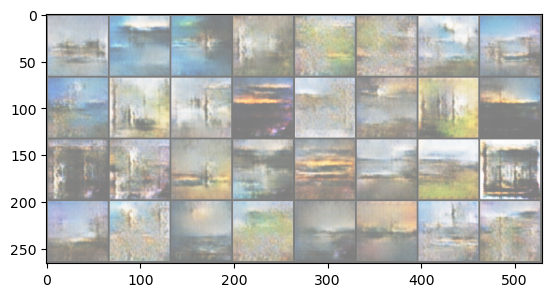

Epoch [43/50] Batch 0/58                   Loss D: 0.0215, loss G: 4.0021


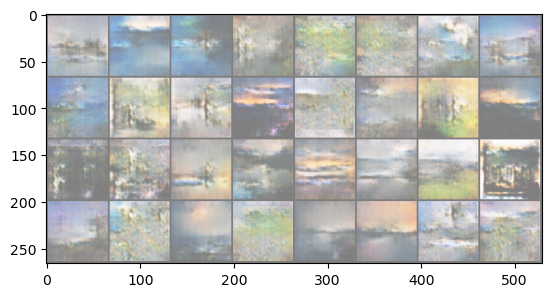

In [26]:
gen.train()
disc.train()

for epoch in range(NUM_EPOCHS):
    for batch_idx, (real, _ ) in enumerate(dataloader):
        real = real.to(device)
        ### create noise tensor
        noise = torch.randn((BATCH_SIZE, Z_DIM, 1, 1)).to(device)
        fake = gen(noise)

        ### Train Discriminator: max log(D(x)) + log(1 - D(G(z)))
        disc_real = disc(real).reshape(-1)
        loss_disc_real = criterion(disc_real, torch.ones_like(disc_real))
        disc_fake = disc(fake.detach()).reshape(-1)
        loss_disc_fake = criterion(disc_fake, torch.zeros_like(disc_fake))
        loss_disc = (loss_disc_real + loss_disc_fake) / 2
        disc.zero_grad()
        loss_disc.backward()
        opt_disc.step()

        ### Train Generator: min log(1 - D(G(z))) <-> max log(D(G(z))
        output = disc(fake).reshape(-1)
        loss_gen = criterion(output, torch.ones_like(output))
        gen.zero_grad()
        loss_gen.backward()
        opt_gen.step()

        ### Print losses occasionally and fake images occasionally
        if batch_idx % 50 == 0:
            print(
                f"Epoch [{epoch}/{NUM_EPOCHS}] Batch {batch_idx}/{len(dataloader)} \
                  Loss D: {loss_disc:.4f}, loss G: {loss_gen:.4f}"
            )
            with torch.no_grad():
                fake = gen(fixed_noise)
                img_grid_real = torchvision.utils.make_grid(real[:32], normalize=True)
                img_grid_fake = torchvision.utils.make_grid(fake[:32], normalize=True)
                show_tensor_images(img_grid_fake)